# EDA Alida Bouatta
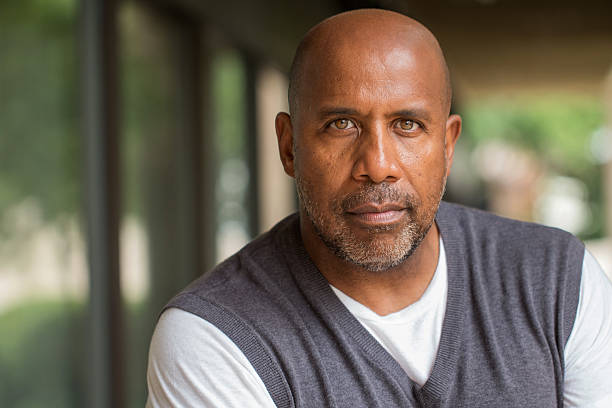

### EDA Eric Robinson hypothesis:
Eric Robinson wants to invest in poor neighborhood, buyer and seller, want a bit of profit

__Question 1__:
Does the location of a house affects the price per square lot? Yes the location affects the price, the poor neighborhood are far from city center, witch cheaper houses.

__Question 2__:
Is there another parameters (other than location) that impacts with the prices? The grade of the house have a strong and positive impact on the houses price.

__Question 3__:
Is it possible to find good properties (good condition, renovated) in a poor neighborhood worth investing in? Yes, some houses are worth investing in, profit
 
margin, good condition so no renovation needed.

### 3 insights regarding the overall data:


1- By calculating the mode of the price per sqr lot and comparing it to 90th percentile price per sqr lot I classified the rich vs poor neighborhood.
There are 8587 houses for the client in 32 poor zip codes/neighborhood

2- (geographical) the center of the "city" has richer neighborhood as illustrated in the plot (latitude vs longitude).

3- Filtering the data by removing more data sets that are not interesting for my client.

4- Filtering the houses by adding more parameters, grades and later on conditions.



In [1]:
import warnings

warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


from matplotlib.ticker import PercentFormatter
plt.rcParams.update({ "figure.figsize" : (8, 5),"axes.facecolor" : "white", "axes.edgecolor":  "black"})
plt.rcParams["figure.facecolor"]= "w"
pd.plotting.register_matplotlib_converters()
pd.set_option('display.float_format', lambda x: '%.3f' % x)

In [2]:
 #importing data 
df_king_county_house_details = pd.read_csv('df_king_county_house_details.csv')
df_king_county_house_sales = pd.read_csv('df_king_county_house_salesda.csv')

In [3]:
print(df_king_county_house_details.shape)
print(df_king_county_house_sales.shape)

(21420, 19)
(21597, 4)


In [4]:
df_king_county_house_sales.info()
df_king_county_house_sales.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   date      21597 non-null  object 
 1   price     21597 non-null  float64
 2   house_id  21597 non-null  int64  
 3   sales_id  21597 non-null  int64  
dtypes: float64(1), int64(2), object(1)
memory usage: 675.0+ KB


,date,price,house_id,sales_id
0,2014-10-13,221900.000,7129300520,1
1,2014-12-09,538000.000,6414100192,2
2,2015-02-25,180000.000,5631500400,3
3,2014-12-09,604000.000,2487200875,4
4,2015-02-18,510000.000,1954400510,5


In [5]:
df_king_county_house_details.info()
df_king_county_house_details.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21420 entries, 0 to 21419
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21420 non-null  int64  
 1   bedrooms       21420 non-null  float64
 2   bathrooms      21420 non-null  float64
 3   sqft_living    21420 non-null  float64
 4   sqft_lot       21420 non-null  float64
 5   floors         21420 non-null  float64
 6   waterfront     19060 non-null  float64
 7   view           21357 non-null  float64
 8   condition      21420 non-null  int64  
 9   grade          21420 non-null  int64  
 10  sqft_above     21420 non-null  float64
 11  sqft_basement  20969 non-null  float64
 12  yr_built       21420 non-null  int64  
 13  yr_renovated   17609 non-null  float64
 14  zipcode        21420 non-null  int64  
 15  lat            21420 non-null  float64
 16  long           21420 non-null  float64
 17  sqft_living15  21420 non-null  float64
 18  sqft_l

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,1000102,6.000,3.000,2400.000,9373.000,2.000,NaN,0.000,3,7,2400.000,0.000,1991,0.000,98002,47.326,-122.214,2060.000,7316.000
1,100100050,3.000,1.000,1320.000,11090.000,1.000,0.000,0.000,3,7,1320.000,0.000,1955,0.000,98155,47.775,-122.304,1320.000,8319.000
2,1001200035,3.000,1.000,1350.000,7973.000,1.500,NaN,0.000,3,7,1350.000,0.000,1954,0.000,98188,47.432,-122.292,1310.000,7491.000
3,1001200050,4.000,1.500,1260.000,7248.000,1.500,NaN,0.000,5,7,1260.000,0.000,1955,NaN,98188,47.433,-122.292,1300.000,7732.000
4,1003000175,3.000,1.000,980.000,7606.000,1.000,0.000,0.000,3,7,980.000,0.000,1954,0.000,98188,47.436,-122.290,980.000,8125.000


In [6]:
#Left join the tables 
df_king_county_house_full = pd.merge(df_king_county_house_details, df_king_county_house_sales, left_on='id', right_on='house_id')
df_king_county_house_full.info()
df_king_county_house_full.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   bedrooms       21597 non-null  float64
 2   bathrooms      21597 non-null  float64
 3   sqft_living    21597 non-null  float64
 4   sqft_lot       21597 non-null  float64
 5   floors         21597 non-null  float64
 6   waterfront     19206 non-null  float64
 7   view           21534 non-null  float64
 8   condition      21597 non-null  int64  
 9   grade          21597 non-null  int64  
 10  sqft_above     21597 non-null  float64
 11  sqft_basement  21145 non-null  float64
 12  yr_built       21597 non-null  int64  
 13  yr_renovated   17749 non-null  float64
 14  zipcode        21597 non-null  int64  
 15  lat            21597 non-null  float64
 16  long           21597 non-null  float64
 17  sqft_living15  21597 non-null  float64
 18  sqft_l

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id,sales_id
0,1000102,6.000,3.000,2400.000,9373.000,2.000,NaN,0.000,3,7,...,0.000,98002,47.326,-122.214,2060.000,7316.000,2014-09-16,280000.000,1000102,2495
1,1000102,6.000,3.000,2400.000,9373.000,2.000,NaN,0.000,3,7,...,0.000,98002,47.326,-122.214,2060.000,7316.000,2015-04-22,300000.000,1000102,2496
2,100100050,3.000,1.000,1320.000,11090.000,1.000,0.000,0.000,3,7,...,0.000,98155,47.775,-122.304,1320.000,8319.000,2014-11-12,275000.000,100100050,7320
3,1001200035,3.000,1.000,1350.000,7973.000,1.500,NaN,0.000,3,7,...,0.000,98188,47.432,-122.292,1310.000,7491.000,2015-03-06,272450.000,1001200035,13278
4,1001200050,4.000,1.500,1260.000,7248.000,1.500,NaN,0.000,5,7,...,NaN,98188,47.433,-122.292,1300.000,7732.000,2014-09-23,259000.000,1001200050,15529


In [7]:
df_king_county_house_full.columns

Index(['id', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15', 'date', 'price', 'house_id', 'sales_id'],
      dtype='object')

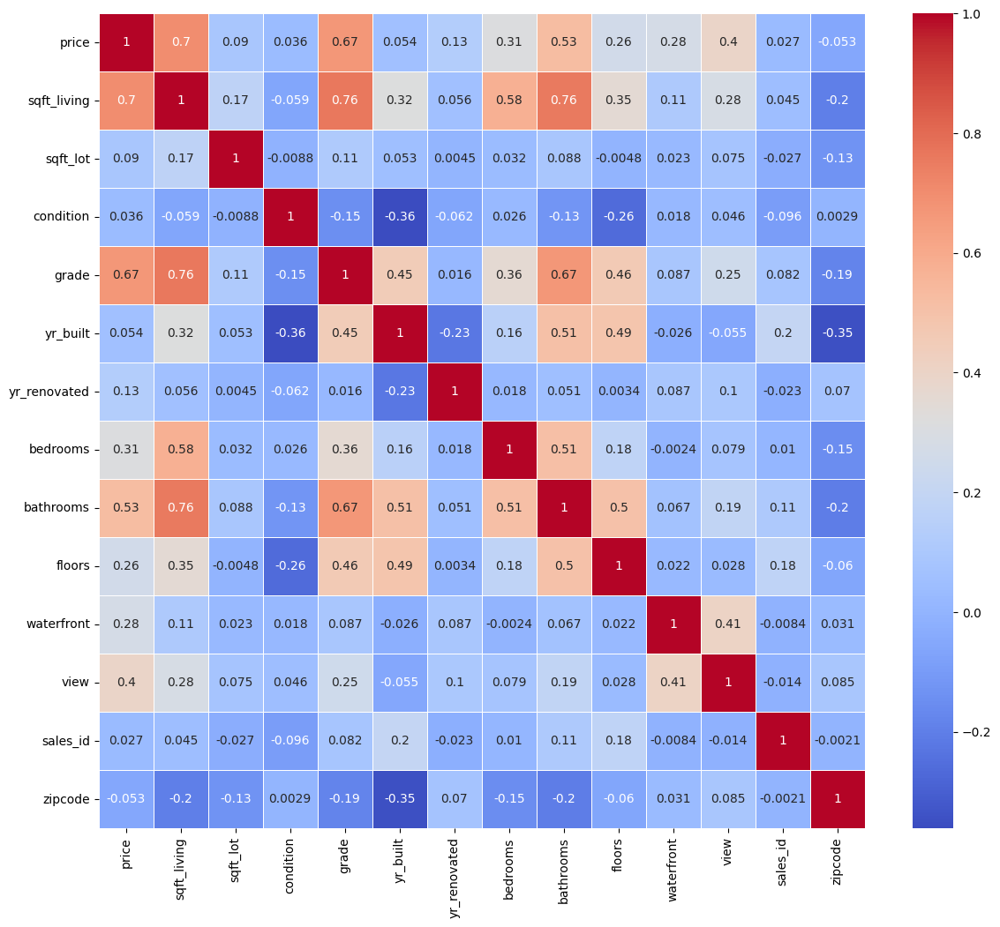

In [8]:
#correlation matrix between the variables 
corr_columns =["price", "sqft_living", "sqft_lot", "condition", "grade", "yr_built", "yr_renovated",'bedrooms', 'bathrooms', 'floors', 'waterfront', 'view', 'sales_id', "zipcode"]
corr_mtrx = df_king_county_house_full[corr_columns].corr()
corr_mtrx
# draw the heatmap 
plt.figure(figsize = (14,12))
ax = sns.heatmap(corr_mtrx, linewidths=.5, annot=True, cmap='coolwarm')

#price positively correlated to sqft_living, grade, bathrooms. The clients is mostly interested in location and price. 

In [10]:
#price per square foot to have a better overview
df_king_county_house_full['price_per_sqft_livingsquare'] = df_king_county_house_full['price'] / df_king_county_house_full['sqft_living']
df_king_county_house_full['price_per_sqft_lot'] = df_king_county_house_full['price'] / df_king_county_house_full['sqft_lot']

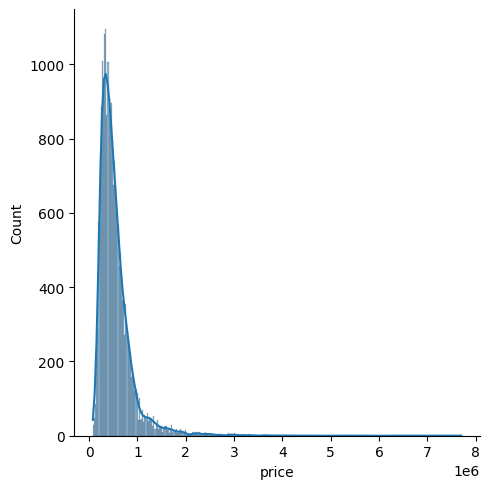

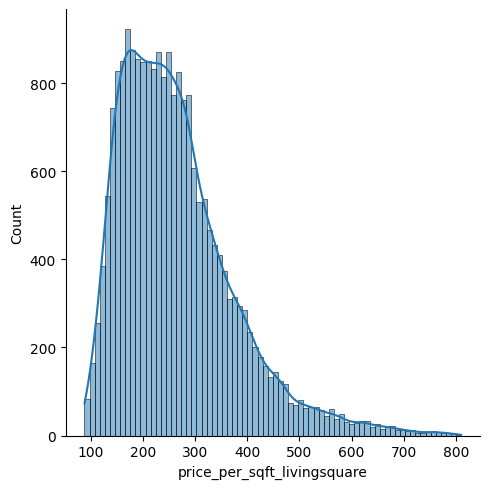

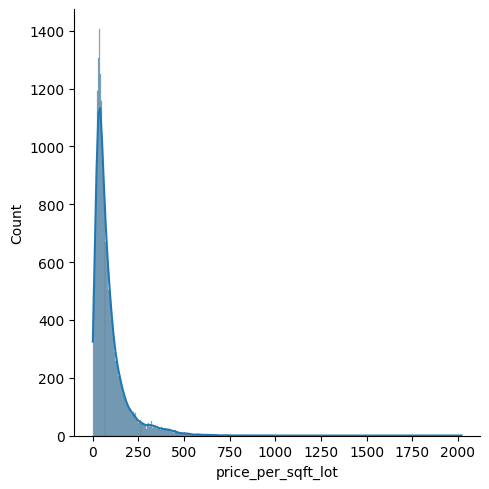

In [11]:
#Histogram to look at some data distribution 
sns.displot( data=df_king_county_house_full['price'], kde=True )
sns.displot( data=df_king_county_house_full['price_per_sqft_livingsquare'], kde=True )
sns.displot( data=df_king_county_house_full['price_per_sqft_lot'], kde=True )

In [12]:
#calculate the mode (most repeated price)
print(df_king_county_house_full.price_per_sqft_lot.mode()[0])
print(df_king_county_house_full.price_per_sqft_livingsquare.mode()[0])
print(df_king_county_house_full.price.mode()[0])

100.0
250.0
350000.0


#### Starting by looking for the Poor Neighborhood, location that the client is interested in

Text(0.5, 1.0, 'Price per zipcode')

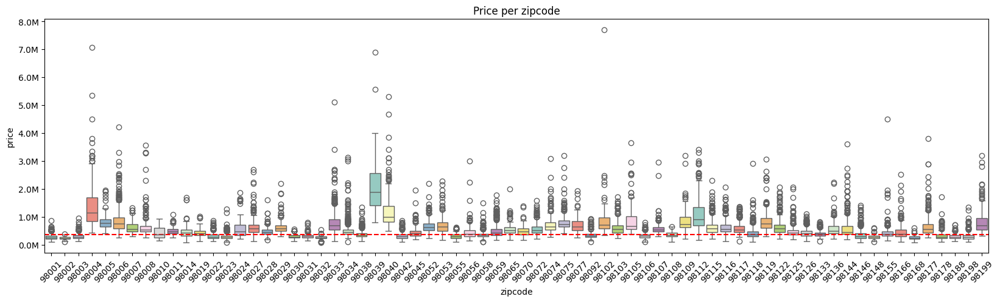

In [47]:
import matplotlib.ticker as mticker
plt.figure(figsize=(20,5))
g = sns.boxplot(x=df_king_county_house_full["zipcode"], y=df_king_county_house_full["price"], palette="Set3")
g.axhline(y = df_king_county_house_full.price.mode()[0], ls='--', c='red')
g.tick_params(axis='x', rotation=45)
g.yaxis.set_major_formatter(mticker.FuncFormatter(lambda x, pos: f'{x*1e-6:.1f}M'))
g.set_title('Price per zipcode')

Text(0.5, 1.0, 'Price per Sqrft lot per zipcode')

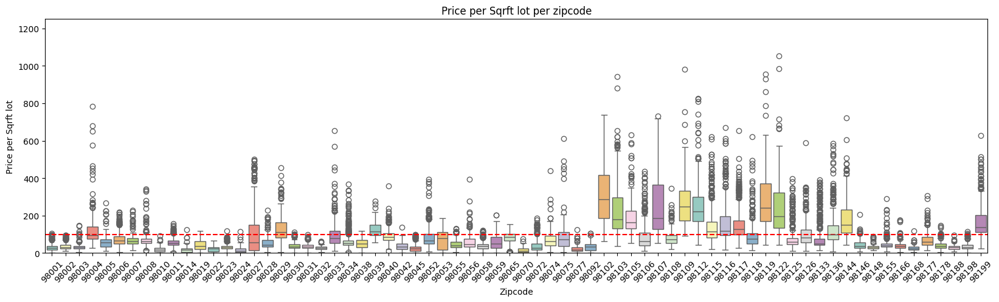

In [44]:
#Price per sqrft lot per zipcode, the point is to try to find the "poor" neighborhood
plt.figure(figsize=(20,5))
g2 = sns.boxplot( x=df_king_county_house_full["zipcode"], y=df_king_county_house_full["price_per_sqft_lot"], palette="Set3")
g2.axhline(y = df_king_county_house_full.price_per_sqft_lot.mode()[0], ls='--', c='red')
g2.tick_params(axis='x', rotation=45)
g2.set(ylim=(0, 1250))

g2.set(xlabel='Zipcode', ylabel='Price per Sqrft lot')
g2.set_title('Price per Sqrft lot per zipcode')


In [36]:
# Group by "zipcode" and calculate the mean of "price_per_sqft_livingsquare"
zipcode_means = df_king_county_house_full.groupby('zipcode')['price_per_sqft_lot'].quantile(q=0.90).reset_index()
mode_value = df_king_county_house_full.price_per_sqft_lot.mode()[0]

df_poor_neig = df_king_county_house_full[df_king_county_house_full['zipcode'].isin(zipcode_means[zipcode_means['price_per_sqft_lot'] < mode_value]['zipcode'])]

df_poor_neig.info()
df_poor_neig.head()
 

<class 'pandas.core.frame.DataFrame'>
Index: 8587 entries, 0 to 21571
Data columns (total 25 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           8587 non-null   int64  
 1   bedrooms                     8587 non-null   float64
 2   bathrooms                    8587 non-null   float64
 3   sqft_living                  8587 non-null   float64
 4   sqft_lot                     8587 non-null   float64
 5   floors                       8587 non-null   float64
 6   waterfront                   7647 non-null   float64
 7   view                         8559 non-null   float64
 8   condition                    8587 non-null   int64  
 9   grade                        8587 non-null   int64  
 10  sqft_above                   8587 non-null   float64
 11  sqft_basement                8409 non-null   float64
 12  yr_built                     8587 non-null   int64  
 13  yr_renovated          

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,lat,long,sqft_living15,sqft_lot15,date,price,house_id,sales_id,price_per_sqft_livingsquare,price_per_sqft_lot
0,1000102,6.000,3.000,2400.000,9373.000,2.000,NaN,0.000,3,7,...,47.326,-122.214,2060.000,7316.000,2014-09-16,280000.000,1000102,2495,116.667,29.873
1,1000102,6.000,3.000,2400.000,9373.000,2.000,NaN,0.000,3,7,...,47.326,-122.214,2060.000,7316.000,2015-04-22,300000.000,1000102,2496,125.000,32.007
2,100100050,3.000,1.000,1320.000,11090.000,1.000,0.000,0.000,3,7,...,47.775,-122.304,1320.000,8319.000,2014-11-12,275000.000,100100050,7320,208.333,24.797
3,1001200035,3.000,1.000,1350.000,7973.000,1.500,NaN,0.000,3,7,...,47.432,-122.292,1310.000,7491.000,2015-03-06,272450.000,1001200035,13278,201.815,34.172
4,1001200050,4.000,1.500,1260.000,7248.000,1.500,NaN,0.000,5,7,...,47.433,-122.292,1300.000,7732.000,2014-09-23,259000.000,1001200050,15529,205.556,35.734


Text(0.5, 1.0, 'Price per Sqrft lot in the poor neighborhood')

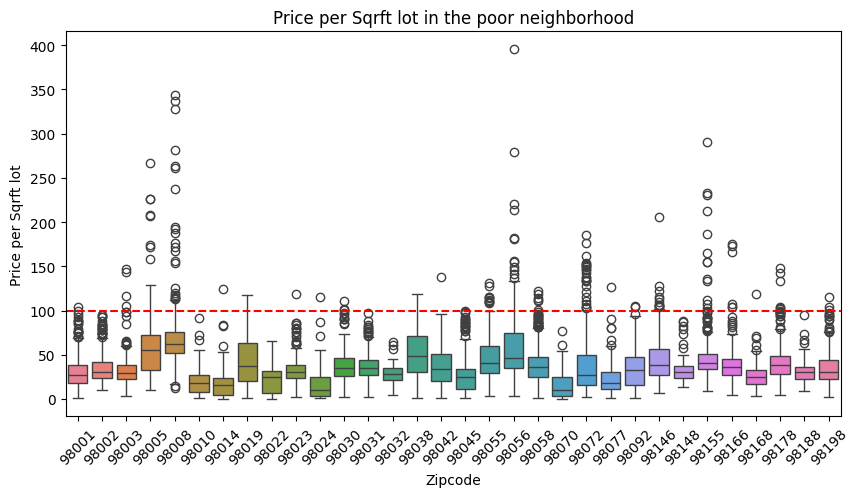

In [42]:
plt.figure(figsize=(10,5))
g3 = sns.boxplot( x=df_poor_neig["zipcode"], y=df_poor_neig["price_per_sqft_lot"], palette="husl" )
g3.axhline(y = mode_value, ls='--', c='red')

g3.tick_params(axis='x', rotation=45)

g3.set(xlabel='Zipcode', ylabel='Price per Sqrft lot')
g3.set_title('Price per Sqrft lot in the poor neighborhood')


### Location Poor Neighborhood found

In [48]:
poor_neig_list = df_poor_neig["id"]

df_king_county_house_full['Ispoor_neig'] = np.where(df_king_county_house_full["id"].isin(poor_neig_list), True, False)
df_king_county_house_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 26 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           21597 non-null  int64  
 1   bedrooms                     21597 non-null  float64
 2   bathrooms                    21597 non-null  float64
 3   sqft_living                  21597 non-null  float64
 4   sqft_lot                     21597 non-null  float64
 5   floors                       21597 non-null  float64
 6   waterfront                   19206 non-null  float64
 7   view                         21534 non-null  float64
 8   condition                    21597 non-null  int64  
 9   grade                        21597 non-null  int64  
 10  sqft_above                   21597 non-null  float64
 11  sqft_basement                21145 non-null  float64
 12  yr_built                     21597 non-null  int64  
 13  yr_renovated    

In [49]:
#convert to dtype "string"
df_king_county_house_full['zipcode'] = df_king_county_house_full.zipcode.astype('string')
df_king_county_house_full.zipcode
df_king_county_house_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 26 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           21597 non-null  int64  
 1   bedrooms                     21597 non-null  float64
 2   bathrooms                    21597 non-null  float64
 3   sqft_living                  21597 non-null  float64
 4   sqft_lot                     21597 non-null  float64
 5   floors                       21597 non-null  float64
 6   waterfront                   19206 non-null  float64
 7   view                         21534 non-null  float64
 8   condition                    21597 non-null  int64  
 9   grade                        21597 non-null  int64  
 10  sqft_above                   21597 non-null  float64
 11  sqft_basement                21145 non-null  float64
 12  yr_built                     21597 non-null  int64  
 13  yr_renovated    

In [40]:
#some houses have same id but different dates 
df_king_county_house_full = df_king_county_house_full.sort_values("date").drop_duplicates("id", keep = "last")


### Using Latitude, Longitude values and Zipcode to have a view of the location

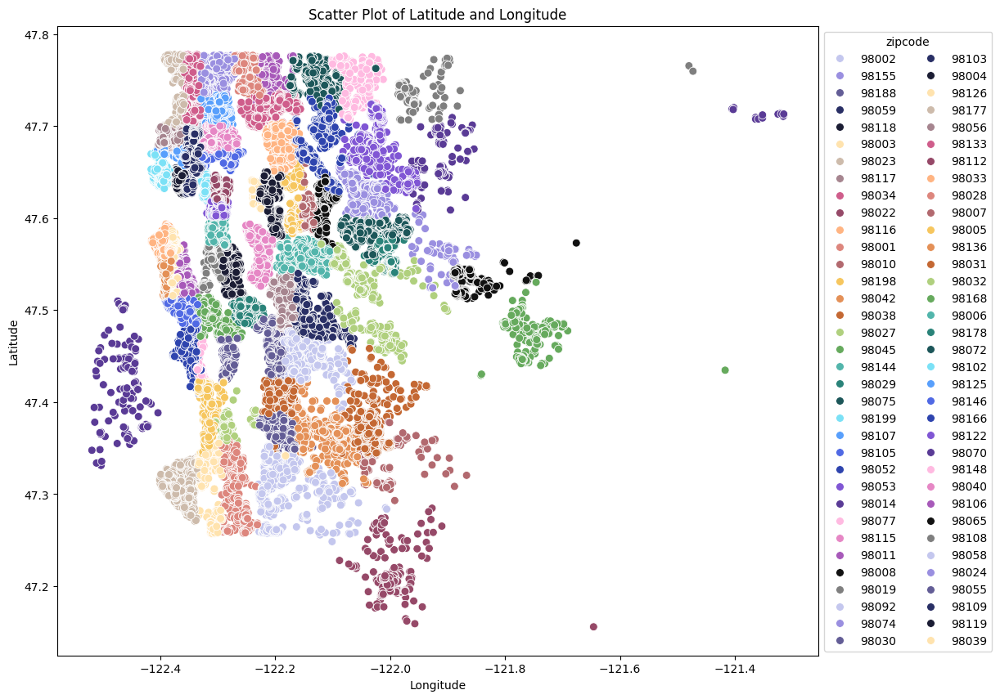

In [50]:
palette32 = ["#c4c7ee", "#9a8fe0", "#635d96", "#292f65", "#1b1d34", "#ffe3ae", "#cdbbab", "#a6858f", "#cf5d8b",
              "#964968", "#ffb482", "#dd867d", "#b2696f", "#f6c65e", "#e49057", "#c46833", "#b0d07e", "#66aa5d",
              "#52b5ab", "#2a8379", "#1c5659", "#7be1f6", "#589ffc", "#5069e4", "#2e44ae", "#8056d4", "#5a3b96",
                "#ffbae1", "#e687c5", "#a759b9", "#111111", "#7f7f7f"
            ]


plt.figure(figsize=(12,10))
ax = sns.scatterplot(data=df_king_county_house_full, x='long', y='lat', hue='zipcode', s=50, palette=palette32)

sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1),ncol=2)
#ax.legend(loc='upper left',ncol=2, title="Title")
plt.ylabel('Latitude')
plt.xlabel('Longitude')
plt.title('Scatter Plot of Latitude and Longitude')

plt.show()

#### Poor Neighborhood

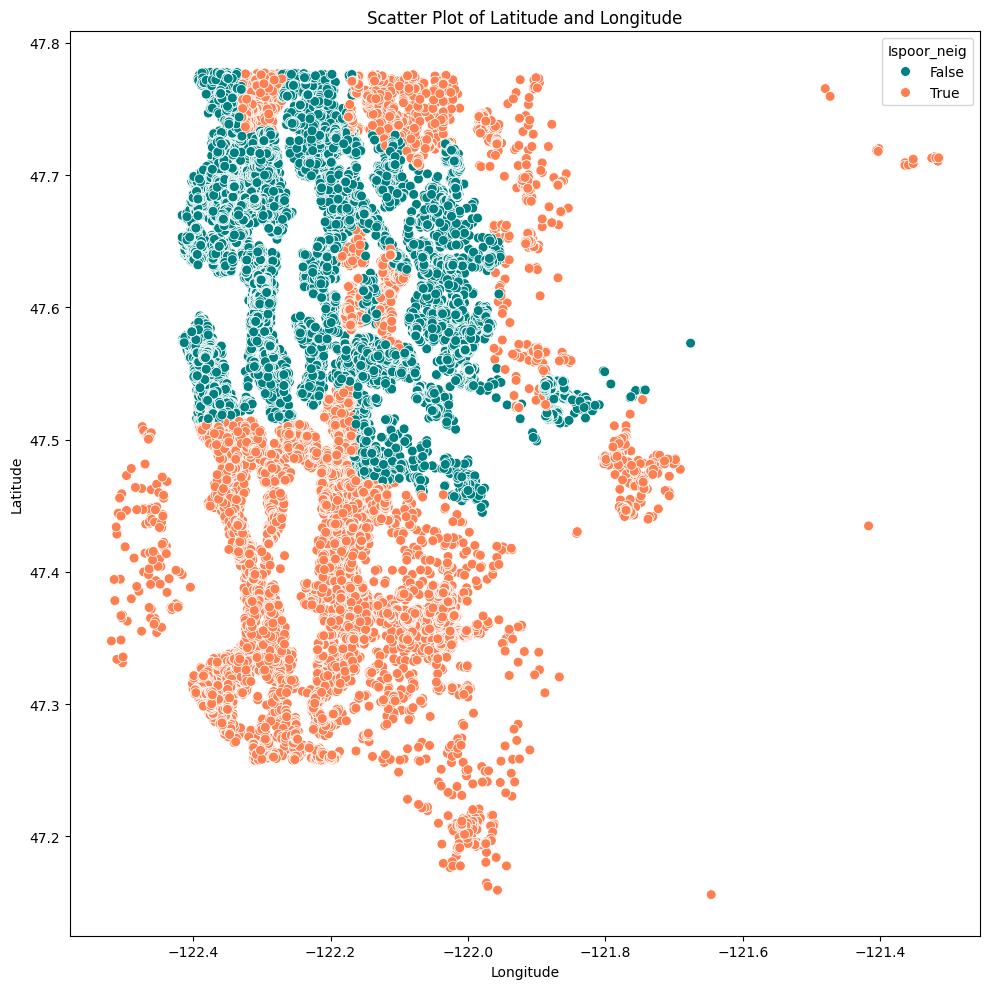

In [93]:
plt.figure(figsize=(10,10))
sns.scatterplot(data=df_king_county_house_full, x='long', y='lat', hue='Ispoor_neig', palette={True: 'coral', False: 'teal'}, s=50)

plt.ylabel('Latitude')
plt.xlabel('Longitude')
plt.title('Scatter Plot of Latitude and Longitude')

plt.show()

#### Importing different packages to get the King County map

In [51]:
#!pip install geopy
#!pip install folium
from geopy.geocoders import Nominatim
import requests
import folium

In [52]:
# Nominatim is used to convert an address into latitude and longitude values
geolocator = Nominatim(user_agent="bv_explorer")
location = geolocator.geocode('King county, WA')
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of King county are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of King county are 47.4873376, -121.8622122.


In [54]:
# create map of Bellevue using latitude and longitude values
map_bv = folium.Map(location=[latitude, longitude], zoom_start=12)

# add markers to map
for lat, lng, zipcode in zip(df_king_county_house_full['lat'], df_king_county_house_full['long'], df_king_county_house_full['zipcode'],):
    label = '{}'.format(zipcode)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='green',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        parse_html=False).add_to(map_bv)  
    
map_bv

#### Column Names and descriptions for King County Data Set to keep

- **id** - unique identified for a house
- **dateDate** - house was sold
- **pricePrice** - is prediction target
- **sqft_livingsquare** - footage of the home
- **sqft_lotsquare** - footage of the lot
- **condition** - How good the condition is ( Overall )
- **grade** - overall grade given to the housing unit, based on King County grading system
- **yr_built** - Built Year
- **yr_renovated** - Year when house was renovated
- **zipcode** - zip
- **lat** - Latitude coordinate
- **long** - Longitude coordinate

In [56]:
df_filtered = df_king_county_house_full[["id","date", "price", "sqft_living", "sqft_lot", "condition", "grade", "yr_built", "yr_renovated", "zipcode", "lat", "long", "price_per_sqft_lot", "price_per_sqft_livingsquare", "Ispoor_neig"]]
df_filtered 

,id,date,price,sqft_living,sqft_lot,condition,grade,yr_built,yr_renovated,zipcode,lat,long,price_per_sqft_lot,price_per_sqft_livingsquare,Ispoor_neig
0,1000102,2014-09-16,280000.000,2400.000,9373.000,3,7,1991,0.000,98002,47.326,-122.214,29.873,116.667,True
1,1000102,2015-04-22,300000.000,2400.000,9373.000,3,7,1991,0.000,98002,47.326,-122.214,32.007,125.000,True
2,100100050,2014-11-12,275000.000,1320.000,11090.000,3,7,1955,0.000,98155,47.775,-122.304,24.797,208.333,True
3,1001200035,2015-03-06,272450.000,1350.000,7973.000,3,7,1954,0.000,98188,47.432,-122.292,34.172,201.815,True
4,1001200050,2014-09-23,259000.000,1260.000,7248.000,5,7,1955,NaN,98188,47.433,-122.292,35.734,205.556,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,993002177,2015-05-06,345000.000,1380.000,1547.000,3,8,2000,NaN,98103,47.691,-122.341,223.012,250.000,False
21593,993002225,2014-06-23,405000.000,1520.000,1245.000,3,8,2004,0.000,98103,47.691,-122.340,325.301,266.447,False
21594,993002247,2014-07-16,430000.000,1550.000,1469.000,3,8,2004,0.000,98103,47.691,-122.341,292.716,277.419,False
21595,993002325,2014-06-23,430000.000,950.000,4625.000,4,7,1949,NaN,98103,47.691,-122.340,92.973,452.632,False


In [47]:
!pip install missingno

### Dealing with NaN

In [57]:
# import missingno
import missingno as msno

In [58]:
df_filtered.isnull().sum()

id                                0
date                              0
price                             0
sqft_living                       0
sqft_lot                          0
condition                         0
grade                             0
yr_built                          0
yr_renovated                   3848
zipcode                           0
lat                               0
long                              0
price_per_sqft_lot                0
price_per_sqft_livingsquare       0
Ispoor_neig                       0
dtype: int64

<Axes: >

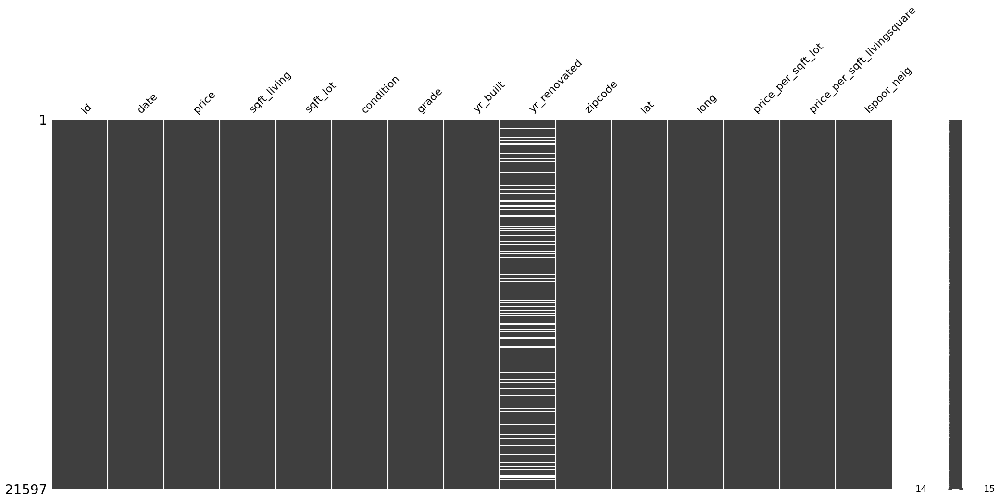

In [59]:
msno.matrix(df_filtered)

In [60]:
print(f"numbers of rows : {df_filtered.shape[0]}")
print(f"missing values in year renovated : {round(df_filtered.yr_renovated.isna().sum()/df_filtered.shape[0]*100,2)} %")

numbers of rows : 21597
missing values in year renovated : 17.82 %


#### The data Year renovated are not formatted correctly 

In [61]:
df_filtered.yr_renovated.tail(50)

21547       0.000
21548       0.000
21549       0.000
21550       0.000
21551       0.000
21552       0.000
21553       0.000
21554       0.000
21555       0.000
21556       0.000
21557       0.000
21558       0.000
21559         NaN
21560       0.000
21561       0.000
21562       0.000
21563   19670.000
21564       0.000
21565       0.000
21566         NaN
21567       0.000
21568         NaN
21569       0.000
21570       0.000
21571         NaN
21572       0.000
21573       0.000
21574       0.000
21575       0.000
21576       0.000
21577         NaN
21578       0.000
21579       0.000
21580         NaN
21581       0.000
21582       0.000
21583       0.000
21584       0.000
21585       0.000
21586       0.000
21587       0.000
21588       0.000
21589       0.000
21590       0.000
21591       0.000
21592         NaN
21593       0.000
21594       0.000
21595         NaN
21596       0.000
Name: yr_renovated, dtype: float64

In [62]:
df_filtered.yr_renovated.max()

20150.0

In [54]:
df_filtered.yr_built.max()

2015

In [63]:
test = df_filtered["yr_renovated"].replace({np.NaN:0})

In [64]:
#what to do about NA in yr_renovated? Imputation
df_filtered["yr_renovated"].mode()

0   0.000
Name: yr_renovated, dtype: float64

In [65]:
#replace NaN by 0
df_filtered["yr_renovated"] = df_filtered["yr_renovated"].replace({np.NaN:0})
df_filtered.head(10)


,id,date,price,sqft_living,sqft_lot,condition,grade,yr_built,yr_renovated,zipcode,lat,long,price_per_sqft_lot,price_per_sqft_livingsquare,Ispoor_neig
0,1000102,2014-09-16,280000.000,2400.000,9373.000,3,7,1991,0.000,98002,47.326,-122.214,29.873,116.667,True
1,1000102,2015-04-22,300000.000,2400.000,9373.000,3,7,1991,0.000,98002,47.326,-122.214,32.007,125.000,True
2,100100050,2014-11-12,275000.000,1320.000,11090.000,3,7,1955,0.000,98155,47.775,-122.304,24.797,208.333,True
3,1001200035,2015-03-06,272450.000,1350.000,7973.000,3,7,1954,0.000,98188,47.432,-122.292,34.172,201.815,True
4,1001200050,2014-09-23,259000.000,1260.000,7248.000,5,7,1955,0.000,98188,47.433,-122.292,35.734,205.556,True
5,1003000175,2014-12-22,221000.000,980.000,7606.000,3,7,1954,0.000,98188,47.436,-122.290,29.056,225.510,True
6,100300280,2014-10-20,355000.000,1430.000,4777.000,3,7,2010,0.000,98059,47.487,-122.152,74.314,248.252,False
7,100300500,2014-11-21,333000.000,1520.000,3041.000,3,7,2009,0.000,98059,47.487,-122.152,109.503,219.079,False
8,100300530,2014-09-25,330000.000,1520.000,3003.000,3,7,2009,0.000,98059,47.488,-122.153,109.890,217.105,False
9,1003400155,2014-08-11,233000.000,1100.000,7657.000,3,7,1955,0.000,98188,47.437,-122.285,30.430,211.818,True


In [66]:
df_filtered["yr_renovated"] = df_filtered["yr_renovated"].astype(str).str[0:4].astype(float).astype('Int64')
df_filtered.info()
df_filtered.head()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 15 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           21597 non-null  int64  
 1   date                         21597 non-null  object 
 2   price                        21597 non-null  float64
 3   sqft_living                  21597 non-null  float64
 4   sqft_lot                     21597 non-null  float64
 5   condition                    21597 non-null  int64  
 6   grade                        21597 non-null  int64  
 7   yr_built                     21597 non-null  int64  
 8   yr_renovated                 21597 non-null  Int64  
 9   zipcode                      21597 non-null  string 
 10  lat                          21597 non-null  float64
 11  long                         21597 non-null  float64
 12  price_per_sqft_lot           21597 non-null  float64
 13  price_per_sqft_l

,id,date,price,sqft_living,sqft_lot,condition,grade,yr_built,yr_renovated,zipcode,lat,long,price_per_sqft_lot,price_per_sqft_livingsquare,Ispoor_neig
0,1000102,2014-09-16,280000.000,2400.000,9373.000,3,7,1991,0,98002,47.326,-122.214,29.873,116.667,True
1,1000102,2015-04-22,300000.000,2400.000,9373.000,3,7,1991,0,98002,47.326,-122.214,32.007,125.000,True
2,100100050,2014-11-12,275000.000,1320.000,11090.000,3,7,1955,0,98155,47.775,-122.304,24.797,208.333,True
3,1001200035,2015-03-06,272450.000,1350.000,7973.000,3,7,1954,0,98188,47.432,-122.292,34.172,201.815,True
4,1001200050,2014-09-23,259000.000,1260.000,7248.000,5,7,1955,0,98188,47.433,-122.292,35.734,205.556,True


In [67]:
#no more NaN 
df_filtered.isnull().sum()

id                             0
date                           0
price                          0
sqft_living                    0
sqft_lot                       0
condition                      0
grade                          0
yr_built                       0
yr_renovated                   0
zipcode                        0
lat                            0
long                           0
price_per_sqft_lot             0
price_per_sqft_livingsquare    0
Ispoor_neig                    0
dtype: int64

#### Calculating the garden size:

In [68]:
df_filtered.eval("garden = sqft_lot - sqft_living", inplace = True) #calculating the garden
df_filtered.columns
df_filtered.head()

,id,date,price,sqft_living,sqft_lot,condition,grade,yr_built,yr_renovated,zipcode,lat,long,price_per_sqft_lot,price_per_sqft_livingsquare,Ispoor_neig,garden
0,1000102,2014-09-16,280000.000,2400.000,9373.000,3,7,1991,0,98002,47.326,-122.214,29.873,116.667,True,6973.000
1,1000102,2015-04-22,300000.000,2400.000,9373.000,3,7,1991,0,98002,47.326,-122.214,32.007,125.000,True,6973.000
2,100100050,2014-11-12,275000.000,1320.000,11090.000,3,7,1955,0,98155,47.775,-122.304,24.797,208.333,True,9770.000
3,1001200035,2015-03-06,272450.000,1350.000,7973.000,3,7,1954,0,98188,47.432,-122.292,34.172,201.815,True,6623.000
4,1001200050,2014-09-23,259000.000,1260.000,7248.000,5,7,1955,0,98188,47.433,-122.292,35.734,205.556,True,5988.000


#### Distribution of parameters per price 

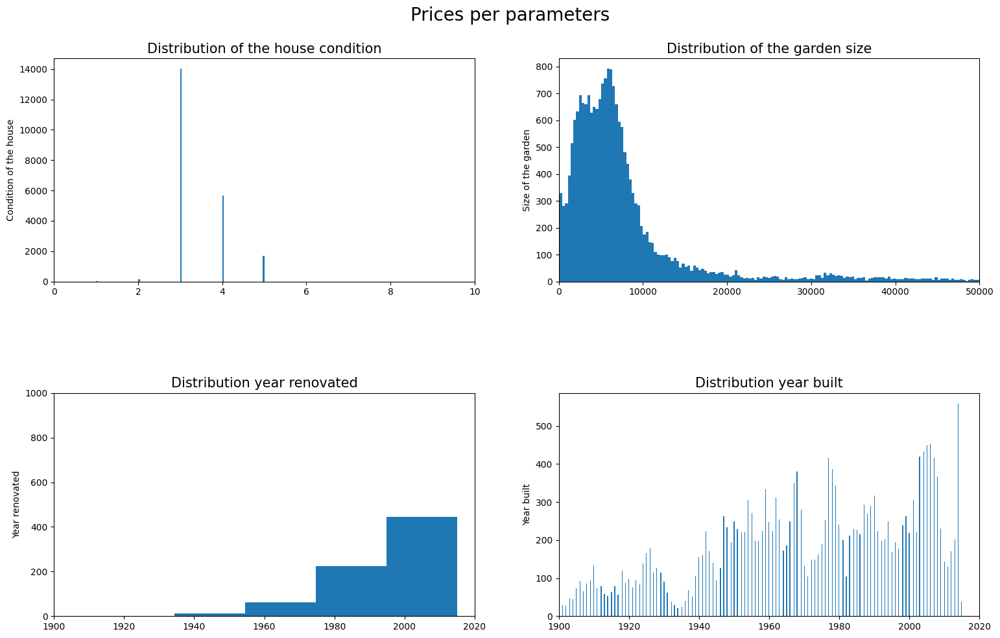

In [69]:
#Looking at the distribution of parameters that might impact the price 
fig, ax = plt.subplots(2,2, figsize=(15,10)) 
plt.suptitle('Prices per parameters', fontsize=20)
fig.tight_layout() 
plt.subplots_adjust(hspace = .5, wspace = .2, top = .9)

ax[0][0].hist(x=df_filtered['condition'], bins=100) 
ax[0][0].set_ylabel("Condition of the house", fontsize = 10) 
ax[0][0].set_xlim(0,10) 
ax[0][0].set_title("Distribution of the house condition", fontsize = 15); 

ax[0][1].hist(x= df_filtered['garden'], bins=5000)
ax[0][1].set_ylabel("Size of the garden", fontsize = 10)
ax[0][1].set_xlim(0,50000)
ax[0][1].set_title("Distribution of the garden size", fontsize = 15);

ax[1][0].hist(x=df_filtered['yr_renovated'], bins=100)
ax[1][0].set_ylabel("Year renovated", fontsize = 10)
ax[1][0].set_xlim(1900,2020)
ax[1][0].set_ylim(0,1000)
ax[1][0].set_title("Distribution year renovated", fontsize = 15);

ax[1][1].hist(x=df_filtered['yr_built'], bins=500)
ax[1][1].set_ylabel("Year built", fontsize = 10)
ax[1][1].set_xlim(1900,2020)
ax[1][1].set_title("Distribution year built", fontsize = 15);




#### Keeping data only from the Poor Neighborhood

In [70]:
df_filtered.eval('location = long <= 121.6 & lat <= 47.4', inplace=True)
filtered_location = df_filtered[df_filtered['location']]
df_filtered

,id,date,price,sqft_living,sqft_lot,condition,grade,yr_built,yr_renovated,zipcode,lat,long,price_per_sqft_lot,price_per_sqft_livingsquare,Ispoor_neig,garden,location
0,1000102,2014-09-16,280000.000,2400.000,9373.000,3,7,1991,0,98002,47.326,-122.214,29.873,116.667,True,6973.000,True
1,1000102,2015-04-22,300000.000,2400.000,9373.000,3,7,1991,0,98002,47.326,-122.214,32.007,125.000,True,6973.000,True
2,100100050,2014-11-12,275000.000,1320.000,11090.000,3,7,1955,0,98155,47.775,-122.304,24.797,208.333,True,9770.000,False
3,1001200035,2015-03-06,272450.000,1350.000,7973.000,3,7,1954,0,98188,47.432,-122.292,34.172,201.815,True,6623.000,False
4,1001200050,2014-09-23,259000.000,1260.000,7248.000,5,7,1955,0,98188,47.433,-122.292,35.734,205.556,True,5988.000,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,993002177,2015-05-06,345000.000,1380.000,1547.000,3,8,2000,0,98103,47.691,-122.341,223.012,250.000,False,167.000,False
21593,993002225,2014-06-23,405000.000,1520.000,1245.000,3,8,2004,0,98103,47.691,-122.340,325.301,266.447,False,-275.000,False
21594,993002247,2014-07-16,430000.000,1550.000,1469.000,3,8,2004,0,98103,47.691,-122.341,292.716,277.419,False,-81.000,False
21595,993002325,2014-06-23,430000.000,950.000,4625.000,4,7,1949,0,98103,47.691,-122.340,92.973,452.632,False,3675.000,False


In [71]:
df_filtered[df_filtered['location']]

,id,date,price,sqft_living,sqft_lot,condition,grade,yr_built,yr_renovated,zipcode,lat,long,price_per_sqft_lot,price_per_sqft_livingsquare,Ispoor_neig,garden,location
0,1000102,2014-09-16,280000.000,2400.000,9373.000,3,7,1991,0,98002,47.326,-122.214,29.873,116.667,True,6973.000,True
1,1000102,2015-04-22,300000.000,2400.000,9373.000,3,7,1991,0,98002,47.326,-122.214,32.007,125.000,True,6973.000,True
16,100500020,2014-09-11,250000.000,1610.000,6600.000,3,7,1994,0,98003,47.283,-122.302,37.879,155.280,True,4990.000,True
20,100600320,2014-08-13,213950.000,1430.000,7000.000,3,6,1968,0,98023,47.302,-122.369,30.564,149.615,True,5570.000,True
21,100600550,2014-08-04,226500.000,1300.000,7370.000,4,7,1976,0,98023,47.303,-122.370,30.733,174.231,True,6070.000,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21361,9804500420,2015-04-24,430000.000,2470.000,50123.000,3,8,1978,0,98022,47.250,-122.000,8.579,174.089,True,47653.000,True
21523,9835800320,2014-08-28,300000.000,2080.000,8750.000,4,8,1967,0,98032,47.375,-122.291,34.286,144.231,True,6670.000,True
21524,9835800750,2014-12-03,247000.000,1640.000,7630.000,4,8,1968,0,98032,47.374,-122.290,32.372,150.610,True,5990.000,True
21525,9835800840,2015-02-04,215000.000,1470.000,7000.000,4,8,1967,0,98032,47.374,-122.289,30.714,146.259,True,5530.000,True


In [72]:
filtered_location.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3770 entries, 0 to 21526
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           3770 non-null   int64  
 1   date                         3770 non-null   object 
 2   price                        3770 non-null   float64
 3   sqft_living                  3770 non-null   float64
 4   sqft_lot                     3770 non-null   float64
 5   condition                    3770 non-null   int64  
 6   grade                        3770 non-null   int64  
 7   yr_built                     3770 non-null   int64  
 8   yr_renovated                 3770 non-null   Int64  
 9   zipcode                      3770 non-null   string 
 10  lat                          3770 non-null   float64
 11  long                         3770 non-null   float64
 12  price_per_sqft_lot           3770 non-null   float64
 13  price_per_sqft_livings

### Plots Q1 : keeping the zipcodes corresponding to the poor neighborhood

In [74]:
palette32 = ["#c4c7ee", "#9a8fe0", "#635d96", "#292f65", "#1b1d34", "#ffe3ae", "#cdbbab", "#a6858f", "#cf5d8b",
              "#964968", "#ffb482", "#dd867d", "#b2696f", "#f6c65e", "#e49057", "#c46833", "#b0d07e", "#66aa5d",
              "#52b5ab", "#2a8379", "#1c5659", "#7be1f6", "#589ffc", "#5069e4", "#2e44ae", "#8056d4", "#5a3b96",
                "#ffbae1", "#e687c5", "#a759b9", "#111111", "#7f7f7f"
            ]

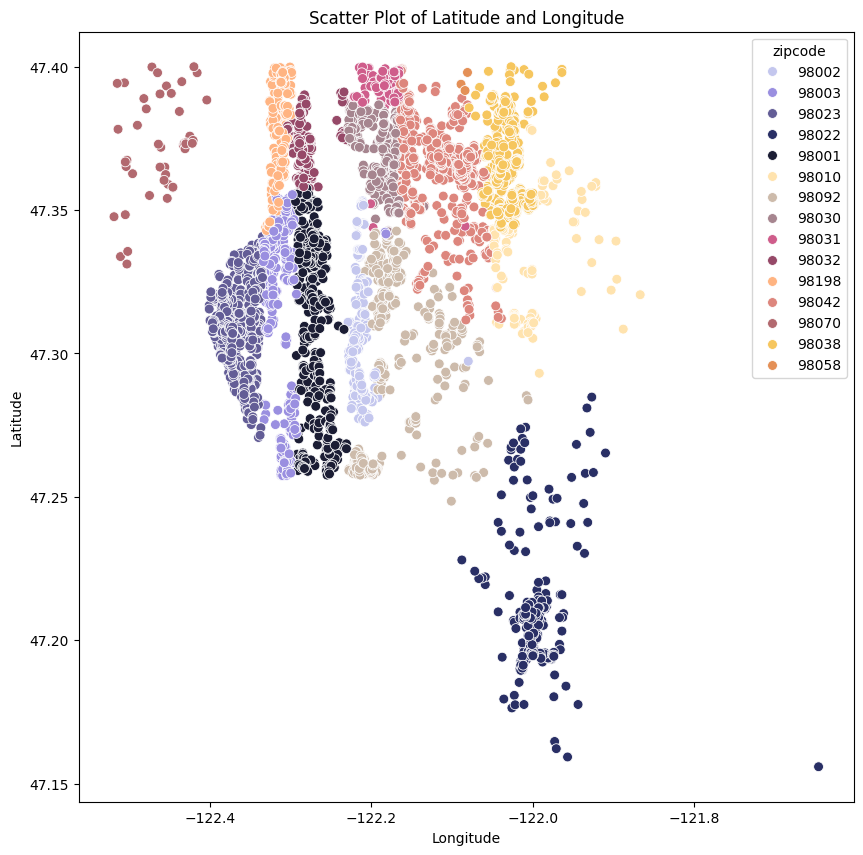

In [77]:
#adding the zipcode
plt.figure(figsize=(10,10))
sns.scatterplot(data=filtered_location, x='long', y='lat', hue='zipcode', palette=palette32, s=50)

plt.ylabel('Latitude')
plt.xlabel('Longitude')
plt.title('Scatter Plot of Latitude and Longitude')

plt.show()

#### Finding other parameters that impact positively the price 

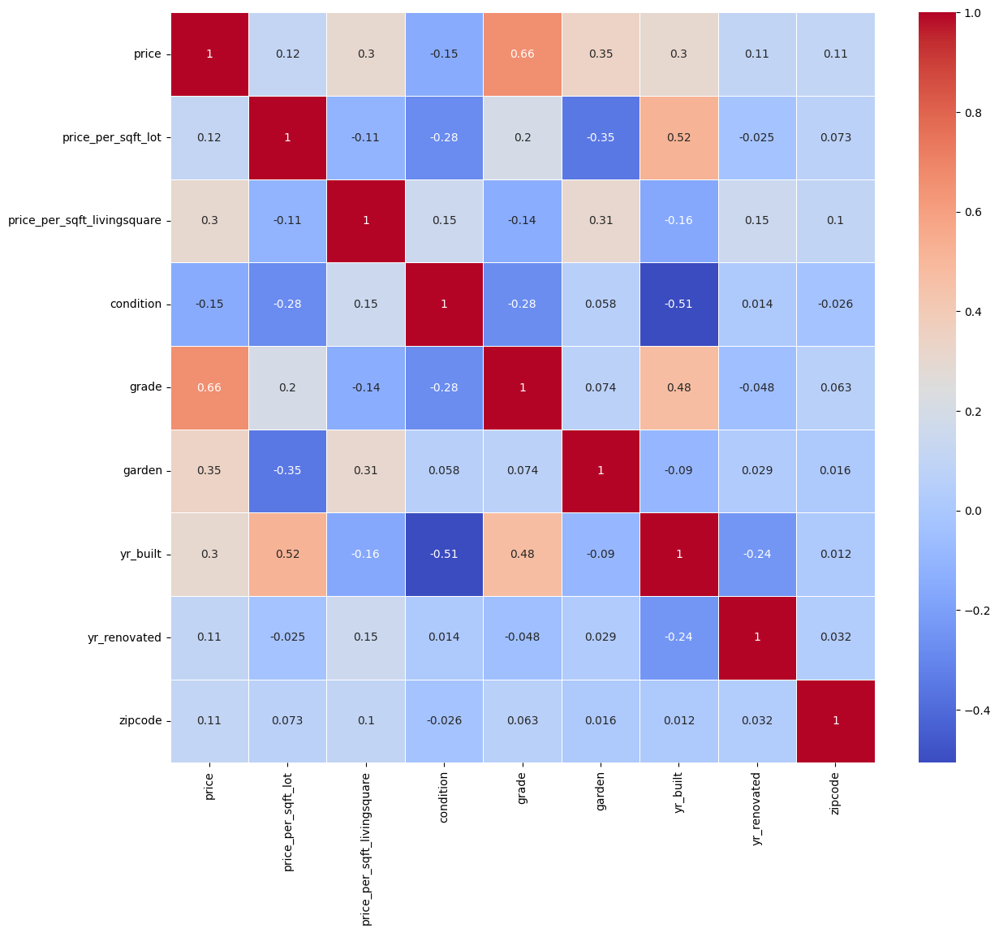

In [78]:
# correlation matrix between these variables
corr_columns =["price", "price_per_sqft_lot", "price_per_sqft_livingsquare", "condition", "grade", "garden", "yr_built", "yr_renovated", "zipcode"]
corr_mtrx = filtered_location[corr_columns].corr()
corr_mtrx
# draw the heatmap 
plt.figure(figsize = (14,12))
ax = sns.heatmap(corr_mtrx, linewidths=.5, annot=True, cmap='coolwarm')

#the grade of the house seems to be a good parameters to filter more data with

### Plots for Q2 

In [79]:
filtered_location['grade'].unique()

array([ 7,  6, 10,  8,  9,  5, 11,  4, 12,  3])

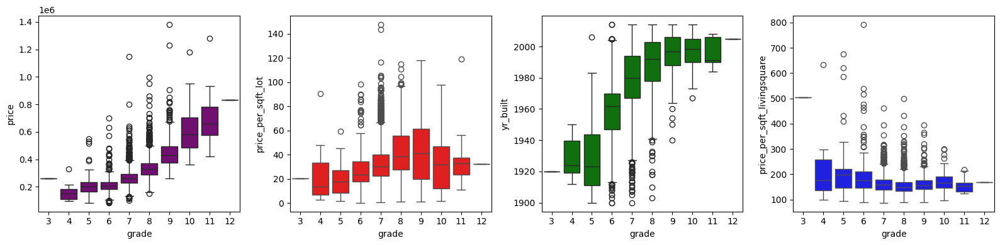

In [80]:
#Grade has a strong correlation on the price 
plt.rcParams["figure.figsize"] = [16.00, 4]
plt.rcParams["figure.autolayout"] = True
f, axes = plt.subplots(1, 4)

sns.boxplot(filtered_location, x="grade", y ="price", color="purple", ax=axes[0])
sns.boxplot(filtered_location, x="grade", y ="price_per_sqft_lot", color="red", ax=axes[1])
sns.boxplot(filtered_location, x="grade", y ="yr_built", color="green", ax=axes[2])
sns.boxplot(filtered_location, x="grade", y ="price_per_sqft_livingsquare", color="blue", ax=axes[3])


plt.show(); # shows the plot. 


In [81]:
filtered_location.sort_values('grade')

,id,date,price,sqft_living,sqft_lot,condition,grade,yr_built,yr_renovated,zipcode,lat,long,price_per_sqft_lot,price_per_sqft_livingsquare,Ispoor_neig,garden,location
4424,2420069251,2015-02-25,262000.000,520.000,12981.000,5,3,1920,0,98022,47.208,-121.995,20.183,503.846,True,12461.000,True
13311,6146600170,2014-07-03,100000.000,660.000,5240.000,4,4,1912,0,98032,47.388,-122.234,19.084,151.515,True,4580.000,True
15169,7203601405,2015-04-14,217000.000,730.000,2400.000,3,4,1934,0,98198,47.350,-122.322,90.417,297.260,True,1670.000,True
2683,1822059057,2014-07-25,152000.000,700.000,13500.000,3,4,1920,0,98031,47.388,-122.208,11.259,217.143,True,12800.000,True
6755,3122069029,2014-06-19,120000.000,990.000,39964.000,2,4,1945,0,98042,47.358,-122.085,3.003,121.212,True,38974.000,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11756,5152960710,2014-05-14,740000.000,5774.000,31675.000,3,11,1984,0,98003,47.347,-122.323,23.362,128.161,True,25901.000,True
1090,1321700030,2014-06-24,575000.000,4620.000,20793.000,4,11,1991,0,98023,47.293,-122.342,27.654,124.459,True,16173.000,True
3434,2025760210,2014-06-11,657500.000,4140.000,24190.000,3,11,2002,0,98092,47.306,-122.150,27.181,158.816,True,20050.000,True
12193,5416300240,2015-02-02,935000.000,5670.000,84267.000,3,11,2008,0,98010,47.323,-122.044,11.096,164.903,True,78597.000,True


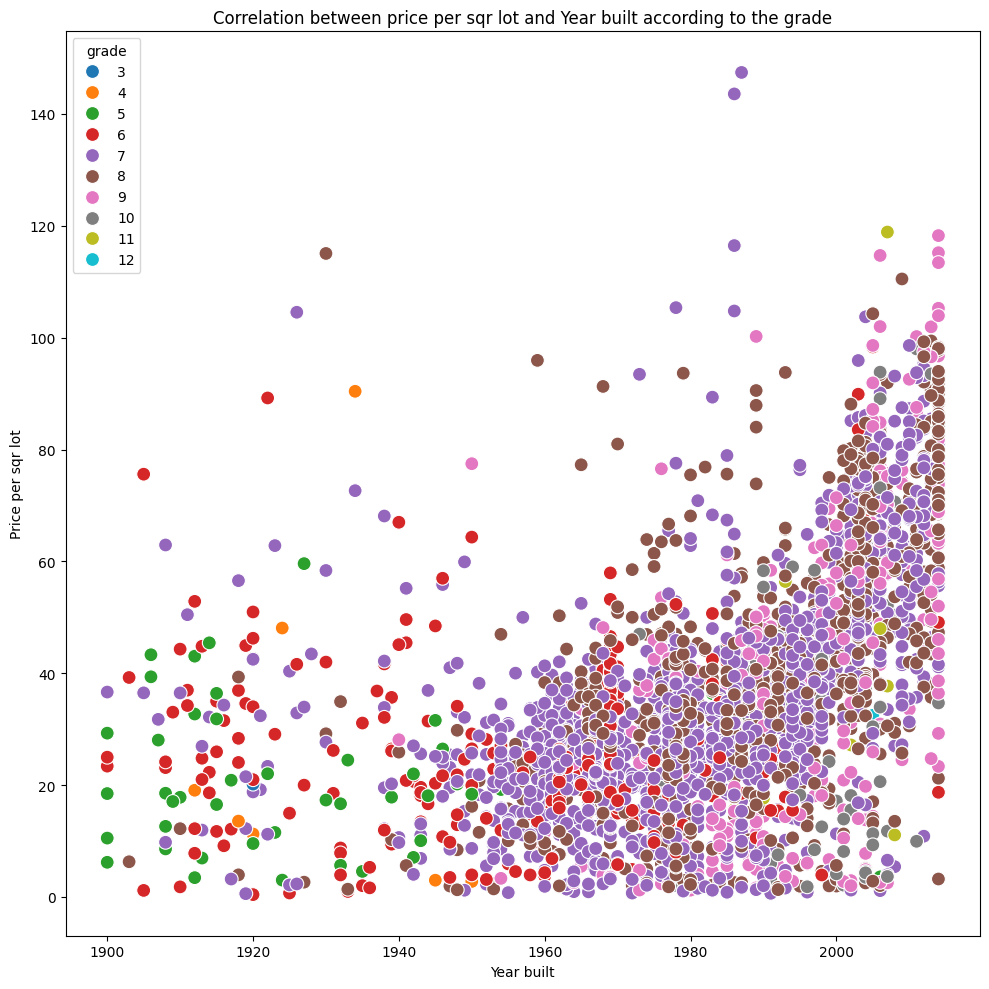

In [82]:
hue_order = filtered_location.grade.sort_values().astype(str).unique()
plt.figure(figsize=(10,10))
sns.scatterplot(data=filtered_location.sort_values('grade'), x='yr_built', y='price_per_sqft_lot', hue=filtered_location['grade'].astype(str), s=100, hue_order=hue_order)

plt.xlabel('Year built')
plt.ylabel('Price per sqr lot')
plt.title('Correlation between price per sqr lot and Year built according to the grade')
plt.show();

#The year the house was build does not impact the grade, so we can just focus on the garde. The grade that we keep are 7, 8, 9, where the prices seem affordable

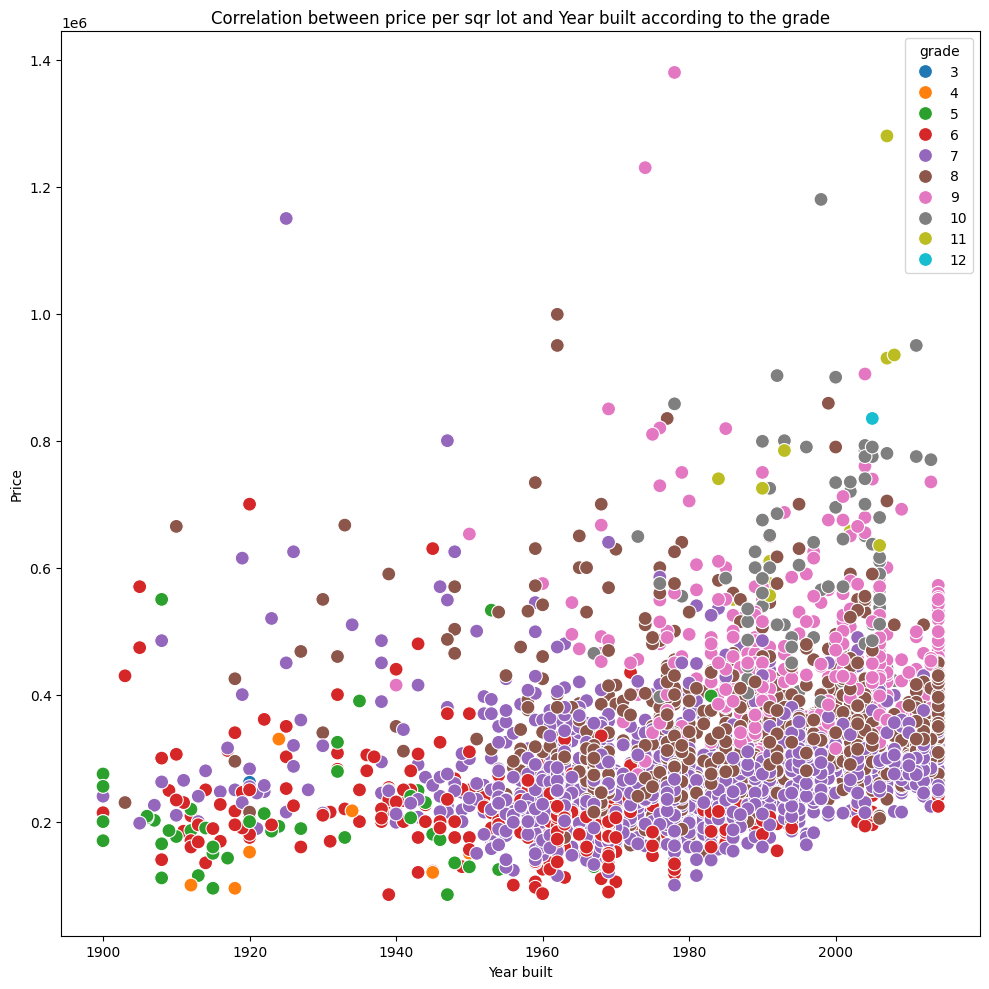

In [83]:
hue_order = filtered_location.grade.sort_values().astype(str).unique()
plt.figure(figsize=(10,10))
sns.scatterplot(data=filtered_location.sort_values('grade'), x='yr_built', y='price', hue=filtered_location['grade'].astype(str), s=100, hue_order=hue_order)

plt.xlabel('Year built')
plt.ylabel('Price')
plt.title('Correlation between price per sqr lot and Year built according to the grade')
plt.show();

#Price per sqrlot have a better visual 

In [84]:
filtered_location['grade']

0        7
1        7
16       7
20       6
21       7
        ..
21361    8
21523    8
21524    8
21525    8
21526    8
Name: grade, Length: 3770, dtype: int64

#### Filtering the data by grades

In [85]:
#grade 7,8,9, price per sqr lot 60, and find the houses that corresponds to that 
good_grade = filtered_location[(filtered_location["grade"]>=7) & (filtered_location["grade"] <= 9)]
good_grade

,id,date,price,sqft_living,sqft_lot,condition,grade,yr_built,yr_renovated,zipcode,lat,long,price_per_sqft_lot,price_per_sqft_livingsquare,Ispoor_neig,garden,location
0,1000102,2014-09-16,280000.000,2400.000,9373.000,3,7,1991,0,98002,47.326,-122.214,29.873,116.667,True,6973.000,True
1,1000102,2015-04-22,300000.000,2400.000,9373.000,3,7,1991,0,98002,47.326,-122.214,32.007,125.000,True,6973.000,True
16,100500020,2014-09-11,250000.000,1610.000,6600.000,3,7,1994,0,98003,47.283,-122.302,37.879,155.280,True,4990.000,True
21,100600550,2014-08-04,226500.000,1300.000,7370.000,4,7,1976,0,98023,47.303,-122.370,30.733,174.231,True,6070.000,True
22,100600860,2015-03-24,237500.000,1050.000,7854.000,4,7,1975,0,98023,47.301,-122.369,30.239,226.190,True,6804.000,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21361,9804500420,2015-04-24,430000.000,2470.000,50123.000,3,8,1978,0,98022,47.250,-122.000,8.579,174.089,True,47653.000,True
21523,9835800320,2014-08-28,300000.000,2080.000,8750.000,4,8,1967,0,98032,47.375,-122.291,34.286,144.231,True,6670.000,True
21524,9835800750,2014-12-03,247000.000,1640.000,7630.000,4,8,1968,0,98032,47.374,-122.290,32.372,150.610,True,5990.000,True
21525,9835800840,2015-02-04,215000.000,1470.000,7000.000,4,8,1967,0,98032,47.374,-122.289,30.714,146.259,True,5530.000,True


#### Writing a function to calculate the prices lower than the mean of each grade in each zipcode

In [94]:
import itertools #iterate to go through complex iteration 

protential_houses = []

zipcodes_list = good_grade.zipcode.unique().tolist()
grades_list = good_grade.grade.unique().tolist()


for zipcode_value in zipcodes_list:
    for grade_value in grades_list:
        temp_df = good_grade[(good_grade['grade'] == grade_value) & (good_grade['zipcode'] == zipcode_value)]
        mean_value = temp_df['price'].mean()
        protential_houses.append(temp_df[temp_df['price'] < mean_value]["id"].dropna().values.tolist())


protential_houses =  list(itertools.chain(*protential_houses))
len(protential_houses)

#Filtering from 3272 houses to 1813


1812

In [87]:
good_grade[(good_grade['grade'] == 7) & (good_grade['zipcode'] == "98010")]['price'].mean()

336882.525

In [88]:
#sort by condition and pick top 3 houses 
candidate_df = good_grade[good_grade["id"].isin(protential_houses)]
top3_df = candidate_df.sort_values("condition", ascending = False).head(3)
candidate_df.sort_values("condition", ascending = False).head(3)


,id,date,price,sqft_living,sqft_lot,condition,grade,yr_built,yr_renovated,zipcode,lat,long,price_per_sqft_lot,price_per_sqft_livingsquare,Ispoor_neig,garden,location
18046,8100000090,2014-11-11,256000.000,1480.000,7200.000,5,7,1995,0,98010,47.313,-122.023,35.556,172.973,True,5720.000,True
7850,3388000040,2014-08-19,260000.000,1600.000,7350.000,5,7,1962,0,98031,47.394,-122.196,35.374,162.500,True,5750.000,True
3900,2212200100,2014-10-22,229950.000,2150.000,7670.000,5,7,1976,0,98031,47.394,-122.189,29.980,106.953,True,5520.000,True


#### Using the previous DataFrame to access all the information about the picked houses

In [89]:
#overall the houses picked are in very good condition even if old 
df_king_county_house_full[df_king_county_house_full["id"].isin(top3_df["id"])]

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,long,sqft_living15,sqft_lot15,date,price,house_id,sales_id,price_per_sqft_livingsquare,price_per_sqft_lot,Ispoor_neig
3900,2212200100,4.000,2.500,2150.000,7670.000,1.000,NaN,0.000,5,7,...,-122.189,1610.000,7350.000,2014-10-22,229950.000,2212200100,9384,106.953,29.980,True
3901,2212200100,4.000,2.500,2150.000,7670.000,1.000,NaN,0.000,5,7,...,-122.189,1610.000,7350.000,2015-04-22,344900.000,2212200100,9385,160.419,44.967,True
7850,3388000040,5.000,1.000,1600.000,7350.000,1.000,0.000,0.000,5,7,...,-122.196,1600.000,7725.000,2014-08-19,260000.000,3388000040,12984,162.500,35.374,True
18046,8100000090,3.000,2.500,1480.000,7200.000,2.000,0.000,0.000,5,7,...,-122.023,1350.000,7200.000,2014-11-11,256000.000,8100000090,2825,172.973,35.556,True


### Plot Q3

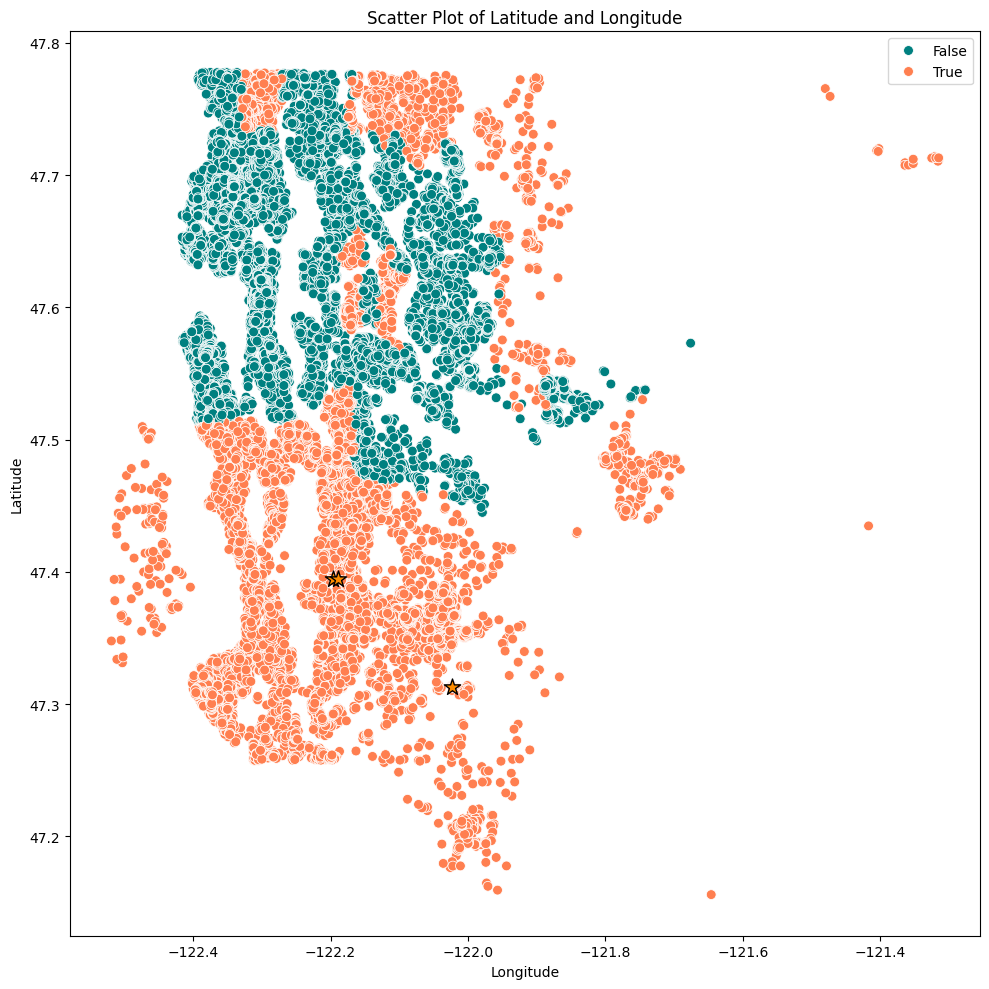

In [91]:
plt.figure(figsize=(10,10))

# Plot the houses, using a softer and more visually pleasing color combination
sns.scatterplot(data=df_king_county_house_full, x='long', y='lat', hue='Ispoor_neig', 
                palette={True: 'coral', False: 'teal'}, s=50)

# Highlight the top 3 houses with a star marker and a standout color
sns.scatterplot(data=top3_df, x='long', y='lat', color='darkorange', s=150, marker='*', edgecolor='black')

# Set labels and title
plt.ylabel('Latitude')
plt.xlabel('Longitude')
plt.title('Scatter Plot of Latitude and Longitude')

plt.show()

In [95]:
# create map of Bellevue using latitude and longitude values
map_bv = folium.Map(location=[latitude, longitude], zoom_start=12)

# add markers to map
for lat, lng, id in zip(top3_df['lat'], top3_df['long'], top3_df['id'],):
    label = '{}'.format(id)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=6,
        popup=label,
        color='green',
        fill=True,
        fill_color='gold',
        fill_opacity=0.7,
        parse_html=False).add_to(map_bv)  
    
map_bv

In [96]:
#Profit margin: mean - actual price 
for row in top3_df.itertuples(index=False):
    grade_value = row[top3_df.columns.get_loc('grade')]
    zipcode_value = row[top3_df.columns.get_loc('zipcode')]
    price_value = row[top3_df.columns.get_loc('price')]
    mean_values = good_grade[(good_grade['grade'] == grade_value) & (good_grade['zipcode'] == zipcode_value)]["price"].mean()
    id_value = row[top3_df.columns.get_loc('id')]
    profit = mean_values - price_value
    print("The house with id " + str(id_value) + " has a price of " + "$" + str(round(price_value)))
    print("The mean selling price of zipcode " + zipcode_value + " is: " + "$" + str(round(mean_values)))
    print("The potential profit is: " + "$" + str(round(profit)))
    print()



The house with id 8100000090 has a price of $256000
The mean selling price of zipcode 98010 is: $336883
The potential profit is: $80883

The house with id 3388000040 has a price of $260000
The mean selling price of zipcode 98031 is: $269181
The potential profit is: $9181

The house with id 2212200100 has a price of $229950
The mean selling price of zipcode 98031 is: $269181
The potential profit is: $39231



In [97]:
!pip list

Package                      Version
---------------------------- --------------
absl-py                      2.1.0
affine                       2.4.0
aggdraw                      1.3.18.post0
aiofiles                     22.1.0
aiohappyeyeballs             2.3.4
aiohttp                      3.10.1
aiosignal                    1.3.1
aiosqlite                    0.20.0
altair                       5.0.1
annotated-types              0.7.0
anyio                        4.4.0
appnope                      0.1.4
argon2-cffi                  23.1.0
argon2-cffi-bindings         21.2.0
arrow                        1.3.0
astor                        0.8.1
asttokens                    2.4.1
astunparse                   1.6.3
async-lru                    2.0.4
attrs                        23.2.0
Babel                        2.15.0
beautifulsoup4               4.12.3
bleach                       6.1.0
blinker                      1.8.2
branca                       0.7.2
cachetools                   